In [8]:
import pandas as pd
from ydata_profiling import ProfileReport
import ipywidgets
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

# Exploratory Data Analysis (EDA) 
# DrivenData: Richter's Predictor: Modeling Earthquake Damage
# EDA of `has_secondary_use`

In [9]:
# import data

file_submission_format = ('../submissions/submission_format.csv')
submission_format = pd.read_csv(file_submission_format)

# The test values
file_test_values = ('../data/test_values.csv')
test_values = pd.read_csv(file_test_values, index_col='building_id')

# The training labels
file_train_labels = ('../data/train_labels.csv')
train_labels = pd.read_csv(file_train_labels, index_col='building_id')

# The training features
file_train_values = ('../data/train_values.csv')
train_values = pd.read_csv(file_train_values, index_col='building_id')

In [10]:
train_values

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,...,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
building_id,,,,,,,,,,,,,,,,,,,,,
802906,6,487,12198,2,30,6,5,t,r,n,...,0,0,0,0,0,0,0,0,0,0
28830,8,900,2812,2,10,8,7,o,r,n,...,0,0,0,0,0,0,0,0,0,0
94947,21,363,8973,2,10,5,5,t,r,n,...,0,0,0,0,0,0,0,0,0,0
590882,22,418,10694,2,10,6,5,t,r,n,...,0,0,0,0,0,0,0,0,0,0
201944,11,131,1488,3,30,8,9,t,r,n,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
688636,25,1335,1621,1,55,6,3,n,r,n,...,0,0,0,0,0,0,0,0,0,0
669485,17,715,2060,2,0,6,5,t,r,n,...,0,0,0,0,0,0,0,0,0,0
602512,17,51,8163,3,55,6,7,t,r,q,...,0,0,0,0,0,0,0,0,0,0


In [11]:
train_labels

,damage_grade
building_id,
802906,3
28830,2
94947,3
590882,2
201944,3
...,...
688636,2
669485,3
602512,3


In [12]:
profile = ProfileReport(train_values, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [13]:
selected_features = ['foundation_type', 
                     'area_percentage', 
                     'height_percentage',
                     'count_floors_pre_eq',
                     'land_surface_condition',
                     'has_superstructure_cement_mortar_stone']

train_values_subset = train_values[selected_features]



/home/solaris/miniconda3/envs/richters-predictor/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/solaris/miniconda3/envs/richters-predictor/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/home/solaris/miniconda3/envs/richters-predictor/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/home/solaris/miniconda3/envs/richters-predictor/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is d

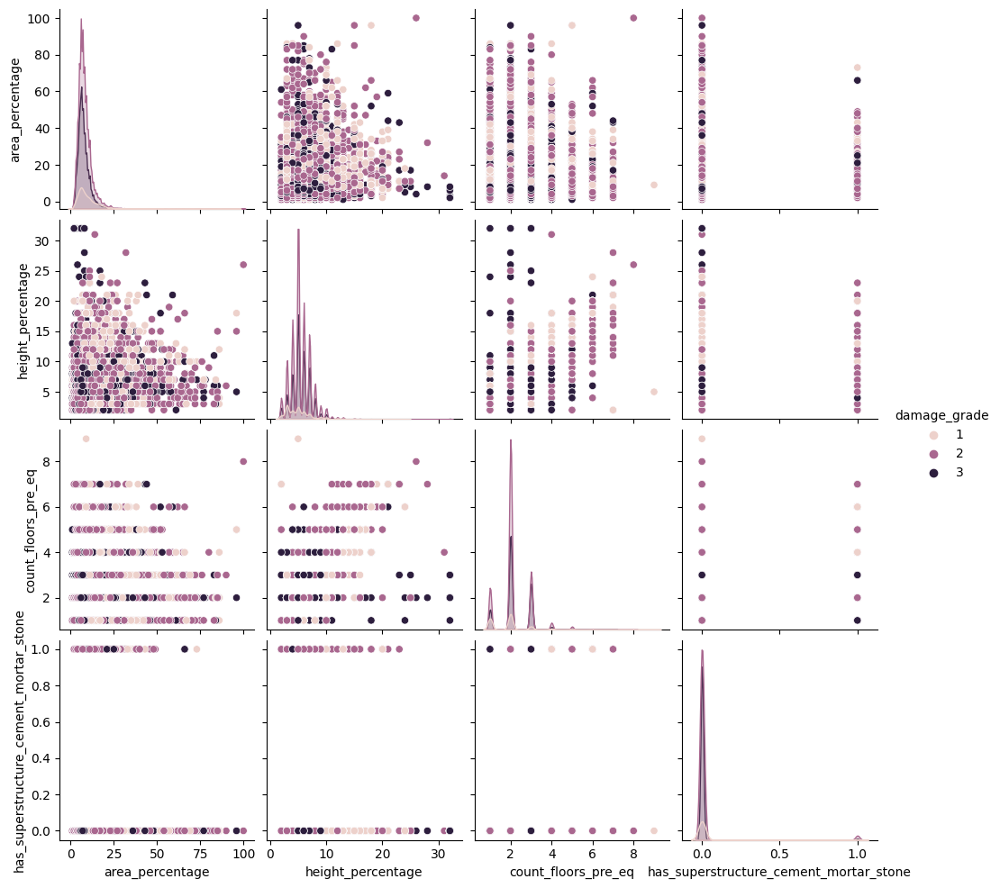

In [27]:
sns_pairplot = sns.pairplot(train_values_subset.join(train_labels), 
             hue='damage_grade')

sns_pairplot.savefig('../graphics/pairplot.png')

In [29]:
#sns_pairplot = sns.pairplot(train_values_subset.join(train_labels), 
#             hue='damage_grade')

# rewrite the above code using plotly express
fig = px.scatter_matrix(train_values_subset.join(train_labels), 
                        dimensions=selected_features,
                        color='damage_grade')
fig.update_layout(width=1000, height=1000)
fig.show()
fi


In [15]:
train_values.describe()

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,...,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
count,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,...,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000
mean,13.900353,701.074685,6257.876148,2.129723,26.535029,8.018051,5.434365,0.088645,0.761935,0.034332,...,0.064378,0.033626,0.008101,0.000940,0.000361,0.001071,0.000188,0.000146,0.000088,0.005119
std,8.033617,412.710734,3646.369645,0.727665,73.565937,4.392231,1.918418,0.284231,0.425900,0.182081,...,0.245426,0.180265,0.089638,0.030647,0.018989,0.032703,0.013711,0.012075,0.009394,0.071364
min,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7.000000,350.000000,3073.000000,2.000000,10.000000,5.000000,4.000000,0.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,12.000000,702.000000,6270.000000,2.000000,15.000000,7.000000,5.000000,0.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,21.000000,1050.000000,9412.000000,2.000000,30.000000,9.000000,6.000000,0.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,30.000000,1427.000000,12567.000000,9.000000,995.000000,100.000000,32.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [16]:
train_values.has_secondary_use.dtype

dtype('int64')

In [17]:
# check if any has_secondary_use* columns are null
train_values.has_secondary_use.isnull().sum()

0

In [18]:
# for loop to check for unique values in has_secondary_use* columns
for col in train_values.columns:
    if 'has_secondary_use' in col:
        print(col, train_values[col].unique())


has_secondary_use [0 1]
has_secondary_use_agriculture [0 1]
has_secondary_use_hotel [0 1]
has_secondary_use_rental [0 1]
has_secondary_use_institution [0 1]
has_secondary_use_school [0 1]
has_secondary_use_industry [0 1]
has_secondary_use_health_post [0 1]
has_secondary_use_gov_office [0 1]
has_secondary_use_use_police [0 1]
has_secondary_use_other [0 1]


In [19]:
# function to convert all has_secondary_use* columns to boolean

def convert_to_bool(df, col):
    df[col] = df[col].astype('bool')

# call function to convert all has_secondary_use* columns to boolean
    
convert_to_bool(train_values, 'has_secondary_use')


# convert all columns has_secondary_use* to boolean
for column in train_values.columns:
    if 'has_secondary_use' in column:
        train_values[column] = train_values[column].astype('bool')


<Axes: >

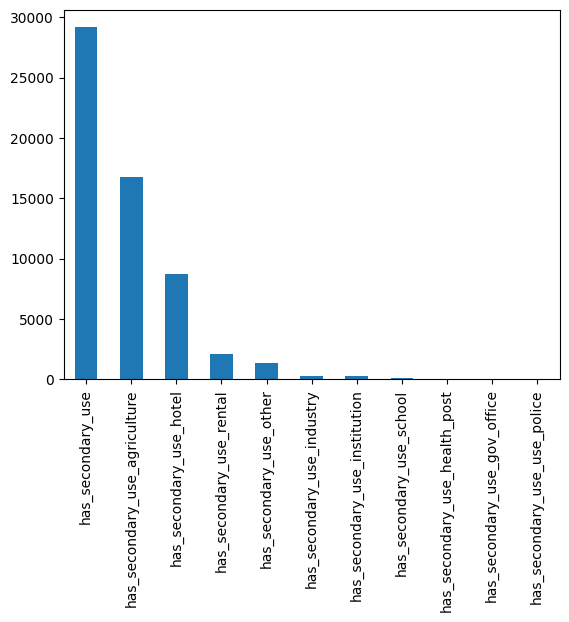

In [20]:

# plot bars in descending order
train_values.filter(like='has_secondary_use').sum().sort_values(ascending=False).plot(kind='bar')



In [21]:
# use plotly express to plot bars in descending order
px.bar(train_values.filter(like='has_secondary_use').sum().sort_values(ascending=False), title='Number of Buildings with Secondary Use', labels={'value':'Number of Buildings', 'index':'Secondary Use Type'})


In [22]:
# use plotly express to plot bars in descending order
px.bar(train_values.filter(like='has_secondary_use').sum().sort_values(ascending=False), title='Number of Buildings with Secondary Use', labels={'value':'Number of Buildings', 'index':'Secondary Use Type'})

# rewrite the above code so has_secondary_use* columns are plotted on the y-axis
px.bar(train_values.filter(like='has_secondary_use').sum().sort_values(ascending=False), orientation='h', title='Number of Buildings with Secondary Use', labels={'value':'Number of Buildings', 'index':'Secondary Use Type'})

# plot a bar plot with has_secondary_use* column as y-axis and frequencies as x-axis. flip x and y axis
px.bar(train_values.filter(like='has_secondary_use').sum().sort_values(ascending=False), orientation='h', title='Number of Buildings with Secondary Use', labels={'value':'Number of Buildings', 'index':'Secondary Use Type'})


 

In [23]:
# descriptive statistics for all boolean columns with has_secondary_use
train_values.filter(like='has_secondary_use').describe()

,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
count,260601,260601,260601,260601,260601,260601,260601,260601,260601,260601,260601
unique,2,2,2,2,2,2,2,2,2,2,2
top,False,False,False,False,False,False,False,False,False,False,False
freq,231445,243824,251838,258490,260356,260507,260322,260552,260563,260578,259267


In [24]:
# left join train_values and train_labels
train_values_labels = train_values.join(train_labels, how='left')

train_values_labels

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,...,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,damage_grade
building_id,,,,,,,,,,,,,,,,,,,,,
802906,6,487,12198,2,30,6,5,t,r,n,...,False,False,False,False,False,False,False,False,False,3
28830,8,900,2812,2,10,8,7,o,r,n,...,False,False,False,False,False,False,False,False,False,2
94947,21,363,8973,2,10,5,5,t,r,n,...,False,False,False,False,False,False,False,False,False,3
590882,22,418,10694,2,10,6,5,t,r,n,...,False,False,False,False,False,False,False,False,False,2
201944,11,131,1488,3,30,8,9,t,r,n,...,False,False,False,False,False,False,False,False,False,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
688636,25,1335,1621,1,55,6,3,n,r,n,...,False,False,False,False,False,False,False,False,False,2
669485,17,715,2060,2,0,6,5,t,r,n,...,False,False,False,False,False,False,False,False,False,3
602512,17,51,8163,3,55,6,7,t,r,q,...,False,False,False,False,False,False,False,False,False,3


In [25]:
# plot damage_grade as bar plot
px.bar(train_values_labels.damage_grade.value_counts(), title='Damage Grade', labels={'value':'Number of Buildings', 'index':'Damage Grade'})
